# Part One


The distress signal leads you to a giant waterfall! Actually, hang on - the signal seems like it's coming from the waterfall itself, <br>and that doesn't make any sense. However, you do notice a little path that leads behind the waterfall.

Correction: the distress signal leads you behind a giant waterfall! <br>There seems to be a large cave system here, and the signal definitely leads further inside.<br>

As you begin to make your way deeper underground, you feel the ground rumble for a moment. <br>Sand begins pouring into the cave! If you don't quickly figure out where the sand is going, <br>you could quickly become trapped!

Fortunately, your familiarity with analyzing the path of falling material will come in handy here. <br>You scan a two-dimensional vertical slice of the cave above you (your puzzle input) and discover that it is mostly air with structures made of rock.

Your scan traces the path of each solid rock structure and reports the x,y coordinates that form the shape of the path, <br>where x represents distance to the right and y represents distance down. <br>Each path appears as a single line of text in your scan. After the first point of each path, each point indicates the end of a straight horizontal or vertical line to be drawn from the previous point.<br>

498,4 -> 498,6 -> 496,6<br>
503,4 -> 502,4 -> 502,9 -> 494,9<br>
This scan means that there are two paths of rock; the first path consists of two straight lines, and the second path consists of three straight lines. <br>(Specifically, the first path consists of a line of rock from 498,4 through 498,6 and another line of rock from 498,6 through 496,6.)<br>

The sand is pouring into the cave from point 500,0.<br>

Sand is produced one unit at a time, and the next unit of sand is not produced until the previous unit of sand comes to rest. <br>A unit of sand is large enough to fill one tile of air in your scan.

A unit of sand always falls down one step if possible. If the tile immediately below is blocked (by rock or sand), <br>the unit of sand attempts to instead move diagonally one step down and to the left. <br>If that tile is blocked, the unit of sand attempts to instead move diagonally one step down and to the right. <br>Sand keeps moving as long as it is able to do so, at each step trying to move down, then down-left, then down-right. <br>If all three possible destinations are blocked, the unit of sand comes to rest and no longer moves, at which point the next unit of sand is created back at the source.<br>

Once all 24 units of sand shown above have come to rest, all further sand flows out the bottom, <br>falling into the endless void. Just for fun, the path any new sand takes before falling forever is shown here with ~:<br>

Using your scan, simulate the falling sand. How many units of sand come to rest before sand starts flowing into the abyss below?

In [1]:
import numpy as np
import sys
from string import ascii_lowercase
from copy import deepcopy
import tqdm 
import matplotlib.pyplot as plt

In [2]:
sys.path.append("..")

In [3]:
from utilities.utils import get_puzzle, submit_answer

In [170]:
path = "../data/sample_14.txt"

In [171]:
with open(path, 'r') as file:
  # Read the contents of the file into a list
  test = file.readlines()

In [172]:
test = [x.replace("\n", "") for x in test]

In [173]:
test

['498,4 -> 498,6 -> 496,6', '503,4 -> 502,4 -> 502,9 -> 494,9']

In [180]:
def setup_map(data, include_floor=False):
    xs, ys = [], []
    for i in data:
        for j in i.split("->"):
            xs.append(int(j.split(",")[1]))
            ys.append(int(j.split(",")[0]))
    shape = (max(xs) + 3, max(ys) + 5)
    arr = np.full(shape, ".")
    arr[0, 500] = "+"
    if include_floor:
        arr[-1, :] = "#"
    return arr

In [102]:
def visualise_map(m, return_map=False):
    m = np.where(m == ".", 0, m)
    m = np.where(m == "#", 10, m)
    m = np.where(m == "o", 20, m)
    m = np.where(m == "~", 30, m)
    m = np.where(m == "+", 50, m)
    if return_map:
        return m
    else:
        plt.imshow(m.astype(int))
    # return 

In [147]:
def draw_path(m, path):
    path_nodes = path.split("->")
    for i, node in enumerate(path_nodes):
        if i + 1 < len(path_nodes):
            y1, x1 = node.split(",")
            y2, x2 = path_nodes[i+1].split(",")
            x1 = int(x1)
            x2 = int(x2)
            y1 = int(y1)
            y2 = int(y2)

            # Generate a sequence of equally spaced values between x1 and x2
            x_values = np.linspace(x1, x2, num=abs(x2 - x1) + 1)

            # Generate a sequence of equally spaced values between y1 and y2
            y_values = np.linspace(y1, y2, num=abs(y2 - y1) + 1)

            # Use these sequences to index the array
            x_values = np.repeat(x_values, len(y_values)) if len(x_values) == 1 else x_values
            y_values = np.repeat(y_values, len(x_values)) if len(y_values) == 1 else y_values
            coords = np.column_stack((x_values, y_values))
            for coord in coords:
                m[int(coord[0]), int(coord[1])] = "#"
    return m

In [188]:
y = np.full([20, 1], ".")
y[-1] = "#"
y

array([['.'],
       ['.'],
       ['.'],
       ['.'],
       ['.'],
       ['.'],
       ['.'],
       ['.'],
       ['.'],
       ['.'],
       ['.'],
       ['.'],
       ['.'],
       ['.'],
       ['.'],
       ['.'],
       ['.'],
       ['.'],
       ['.'],
       ['#']], dtype='<U1')

In [189]:
def drop_sand(m, sand=None, verbose=True, method="abyss"):
    if method not in ["abyss", "full"]:
        raise ValueError(f"{method} not in the accepted methods!")
    sand = [0, 500] if sand is None else sand
    if verbose:
        print(f"sand = {sand}")
    drop = True
    reached_abyss = False
    reached_full = False
    while drop:
        new_sand = deepcopy(sand)
        new_sand[0] += 1
        if new_sand[0] >= m.shape[0]:
            if verbose:
                print("sand entering abyss!")
            if method == "abyss":
                m[sand[0], sand[1]] = "~"
                drop = False
                reached_abyss = True
        else:
            if m[new_sand[0], new_sand[1]] != ".":
                if verbose:
                    print(f"Try left fall")
                fall_left = deepcopy(sand)
                fall_left[0] += 1
                fall_left[1] -= 1
                if fall_left[1] < 0:
                    new_col = np.full([m.shape[0],1], ".")
                    new_col[-1] = "#"
                    m = np.column_stack((new_col, m))
                if m[fall_left[0], fall_left[1]] == ".":
                    m, reached_abyss, reached_full = drop_sand(m, sand=fall_left, verbose=verbose)
                else:
                    if verbose:
                        print(f"Try right fall")
                    fall_right = deepcopy(sand)
                    fall_right[0] += 1
                    fall_right[1] += 1
                    if fall_right[1] >= m.shape[1]:
                        new_col = np.full([m.shape[0],1], ".")
                        new_col[-1] = "#"
                        m = np.column_stack((m, new_col))
                    if m[fall_right[0], fall_right[1]] == ".":
                        m, reached_abyss, reached_full = drop_sand(m, sand=fall_right, verbose=verbose)
                    else:
                        m[sand[0], sand[1]] = "o"
                        if sand[0] == 0 and sand[1] == 500 and method == "full":
                            reached_full = True
                        drop = False
                drop = False
            else:
                sand = deepcopy(new_sand)
    return m, reached_abyss, reached_full
                

In [140]:
m = setup_map(data)

In [141]:
for path in data:
    m=draw_path(m, path)

[  4. 498.]
[  5. 498.]
[  6. 498.]
[  6. 498.]
[  6. 497.]
[  6. 496.]
[  4. 503.]
[  4. 502.]
[  4. 502.]
[  5. 502.]
[  6. 502.]
[  7. 502.]
[  8. 502.]
[  9. 502.]
[  9. 502.]
[  9. 501.]
[  9. 500.]
[  9. 499.]
[  9. 498.]
[  9. 497.]
[  9. 496.]
[  9. 495.]
[  9. 494.]


25


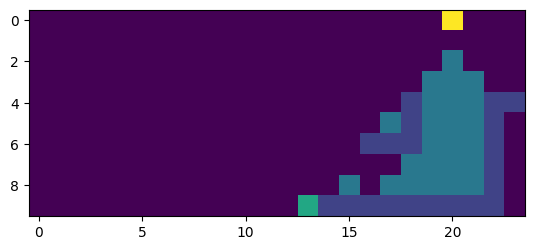

In [142]:
counter = 0
abyss = False
array_list = []
while not abyss:
    m, abyss = drop_sand(m, verbose=False)
    array_list.append(deepcopy(m[:, 480:]))
    counter += 1
print(counter)
visualise_map(m[:, 480:])

In [143]:
array_list = [np.uint8(np.asarray(visualise_map(arr, True), dtype=int))*4 for arr in array_list]

In [144]:
import imageio
from IPython.display import Image

# Create a GIF from the list of arrays
# images = [imageio.imwrite(arr, 'gif') for arr in array_list]
imageio.mimwrite('animation.gif', array_list, fps=10)

# Display the GIF in the notebook
Image(filename='animation.gif', width=500)

### Real data

In [146]:
data = get_puzzle(year=2022, day=14)
data = data.split("\n")
len(data)

148

In [157]:
m = setup_map(data)

In [158]:
for path in data:
    m=draw_path(m, path)

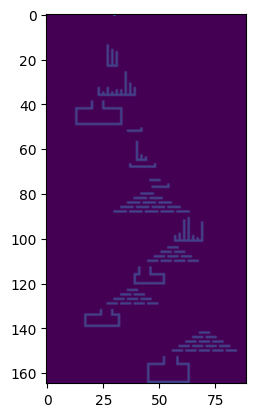

In [159]:
visualise_map(m[:, 470:])

1017


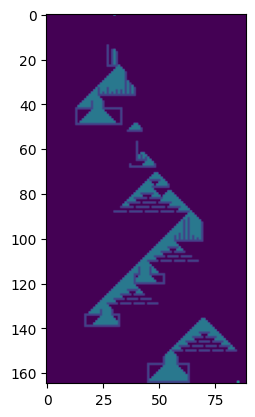

In [160]:
counter = 0
abyss = False
array_list = []
while not abyss:
    m, abyss = drop_sand(m, verbose=False)
    array_list.append(deepcopy(m[:, 470:]))
    counter += 1
print(counter)
visualise_map(m[:, 470:])

In [219]:
def make_gif(array_list, speed=10):
    new_array_list = []
    max_width = max([arr.shape[1] for arr in array_list])
    for arr in tqdm.tqdm(array_list):
        if arr.shape[1] < max_width:
            new_cols = np.full([arr.shape[0], max_width - arr.shape[1]], ".")
            if max_width - arr.shape[1] == 1:
                new_cols[-1] = "#"
            else:
                new_cols[-1, :] = "#"
            arr = np.column_stack((arr, new_cols))
        new_array_list.append(arr)
    array_list = [np.uint8(np.asarray(visualise_map(arr, True), dtype=int))*4 for arr in tqdm.tqdm(new_array_list)]
    # Create a GIF from the list of arrays
    # images = [imageio.imwrite(arr, 'gif') for arr in array_list]
    imageio.mimwrite('animation.gif', array_list, fps=speed)

    # Display the GIF in the notebook
    return Image(filename='animation.gif', width=500)

In [161]:
array_list = [np.uint8(np.asarray(visualise_map(arr, True), dtype=int))*4 for arr in array_list]

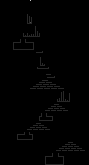

In [163]:
# Create a GIF from the list of arrays
# images = [imageio.imwrite(arr, 'gif') for arr in array_list]
imageio.mimwrite('animation.gif', array_list, fps=50)

# Display the GIF in the notebook
Image(filename='animation.gif', width=500)

In [164]:
submit_answer(1016, "a", 14, 2022)

That's the right answer!  You are one gold star closer to collecting enough star fruit. [Continue to Part Two]


# Part Two

In [190]:
m = setup_map(test, include_floor=True)

In [191]:
for path in test:
    m=draw_path(m, path)

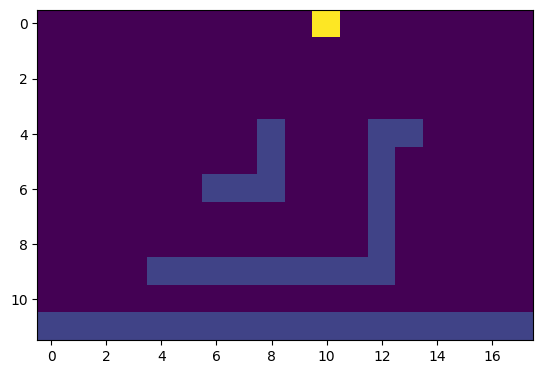

In [192]:
visualise_map(m[:, 490:])

93


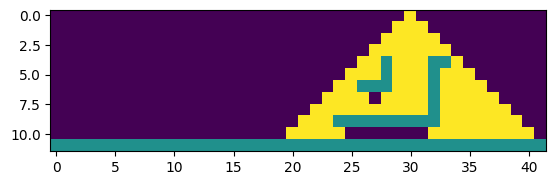

In [193]:
counter = 0
full = False
array_list = []
while not full:
    m, _, full = drop_sand(m, verbose=False, method="full")
    array_list.append(deepcopy(m[:, 470:]))
    counter += 1
print(counter)
visualise_map(m[:, 470:])

In [209]:
make_gif(array_list)

### real data

In [211]:
m = setup_map(data, include_floor=True)

In [212]:
for path in data:
    m=draw_path(m, path)

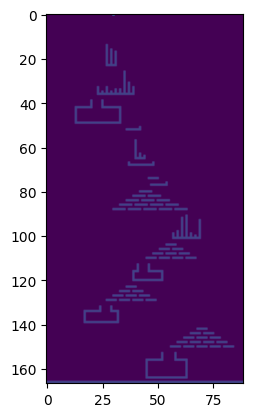

In [214]:
visualise_map(m[:, 470:])

25402


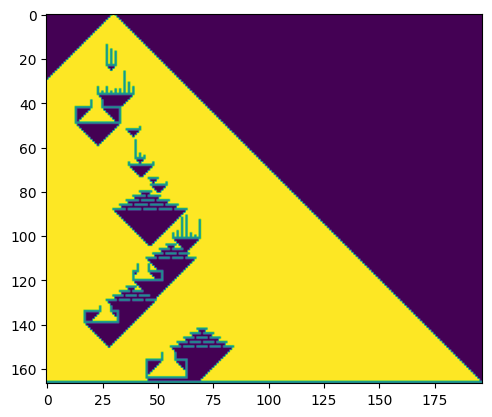

In [215]:
counter = 0
full = False
array_list = []
while not full:
    m, _, full = drop_sand(m, verbose=False, method="full")
    array_list.append(deepcopy(m[:, 470:]))
    counter += 1
print(counter)
visualise_map(m[:, 470:])

100%|███████████████████████████████████████████████████████████| 25402/25402 [04:12<00:00, 100.77it/s]


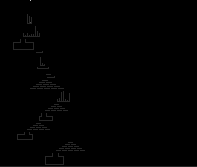

In [221]:
make_gif(array_list, speed=500)

In [222]:
submit_answer(25402, 'b', 14, 2022)

That's the right answer!  You are one gold star closer to collecting enough star fruit.You have completed Day 14! You can [Shareon
  Twitter
Mastodon] this victory or [Return to Your Advent Calendar].
